In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [ ]:
!pip install opencv-python
!pip install face_recognition
!pip install scikit-learn

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.1/100.1 MB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566170 sha256=e1ff157b1e29c47d670a78cdc7b7099771428af4330c72ddcb3ae6393f5ecaed
  Stored in directory: /root/.cache/pip/wheels/7a/eb/cf/e9eced74122b679557f597bb7c8e4c739cfcac526db1fd523d
Successfully built face-recognition-models


In [ ]:
import os
import face_recognition
import cv2
import time
from sklearn import neighbors
import pickle
from google.colab.patches import cv2_imshow

# To Train the Students

In [ ]:

# Function to train face recognition model
def train_face_recognition_model(data_path):
    X = []
    y = []

    for class_folder in os.listdir(data_path):
        class_path = os.path.join(data_path, class_folder)
        for image_file in os.listdir(class_path):
            image_path = os.path.join(class_path, image_file)
            image = face_recognition.load_image_file(image_path)
            face_encodings = face_recognition.face_encodings(image)

            if len(face_encodings) > 0:
                X.append(face_encodings[0])
                y.append(class_folder)

    knn_clf = neighbors.KNeighborsClassifier(n_neighbors=2, algorithm='ball_tree')
    knn_clf.fit(X, y)

    # Save the model to Google Drive
    with open('/content/face_recognition_model.pkl', 'wb') as model_file:
        pickle.dump(knn_clf, model_file)

In [ ]:
# Train the face recognition model
data_path = '/content/drive/MyDrive/Project/Classmates'
train_face_recognition_model(data_path)


In [ ]:
# Function to recognize faces in an image
def recognize_faces(image_path, model_path):
    # Load the trained model
    with open(model_path, 'rb') as model_file:
        knn_clf = pickle.load(model_file)

    image = face_recognition.load_image_file(image_path)
    face_locations = face_recognition.face_locations(image)
    face_encodings = face_recognition.face_encodings(image, face_locations)

    for face_location, face_encoding in zip(face_locations, face_encodings):
        # Use knn_clf.predict instead of knn_clf.predict_proba
        name = knn_clf.predict([face_encoding])[0]

        # Draw a box around the face
        top, right, bottom, left = face_location
        cv2.rectangle(image, (left, top), (right, bottom), (0, 255, 0), 2)

        # Draw the name on the image
        font = cv2.FONT_HERSHEY_DUPLEX
        fontScale = 1.0  # Adjust this value to increase or decrease the font size
        fontColor = (255, 0, 0)  # BGR color format, (0, 0, 255) for red, (0, 255, 0) for green, etc.
        cv2.putText(image, name, (left + 6, bottom - 6), font, fontScale, fontColor, 1)

    # Display the image using cv2_imshow
    cv2_imshow(image)


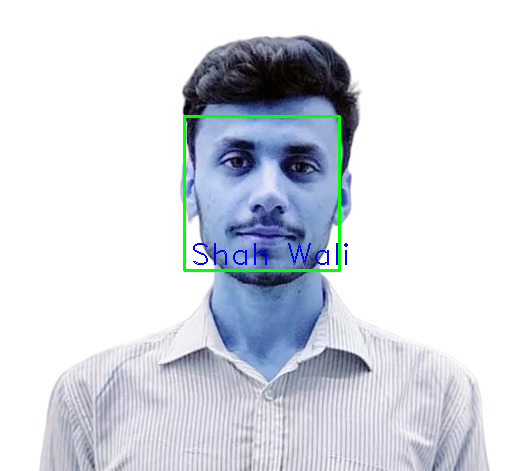

In [ ]:
# Test the face recognition on an unseen image
model_path = '/content/drive/MyDrive/Project/face_recognition_model.pkl'
test_image_path = '/content/Shah Wali-.jpg'
recognize_faces(test_image_path, model_path)

# For Video

<ipython-input-8-f133b23df483>:48: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,
<ipython-input-8-f133b23df483>:48: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,


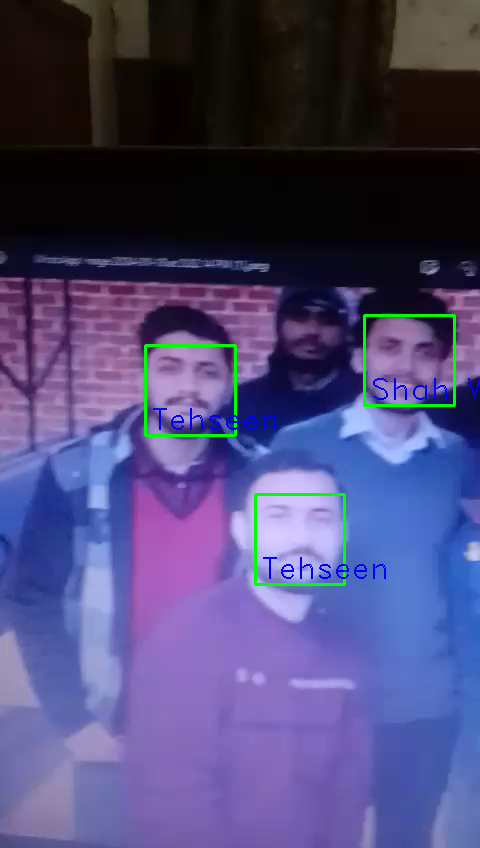

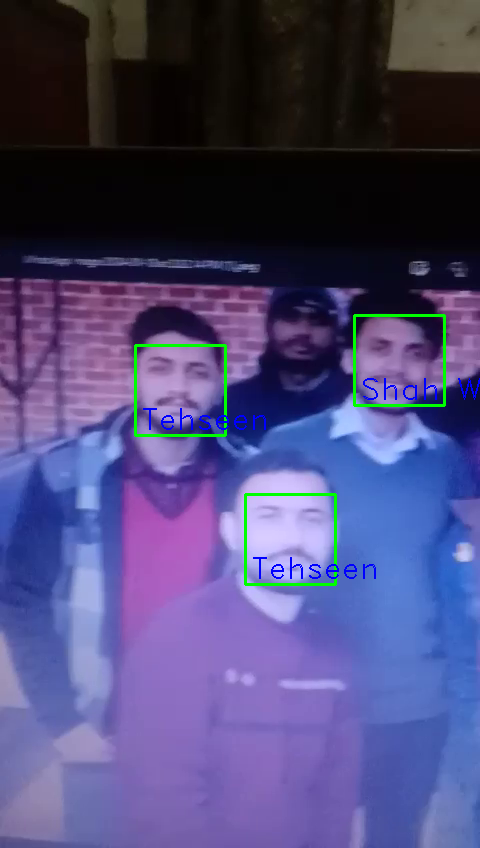

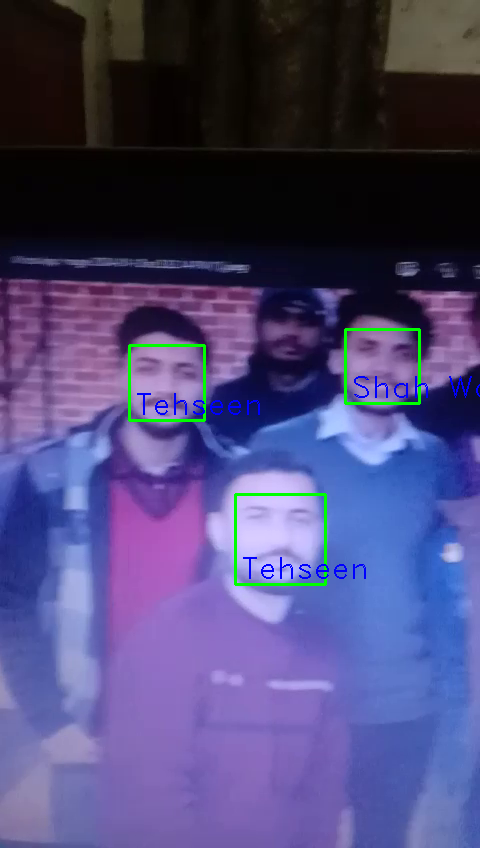

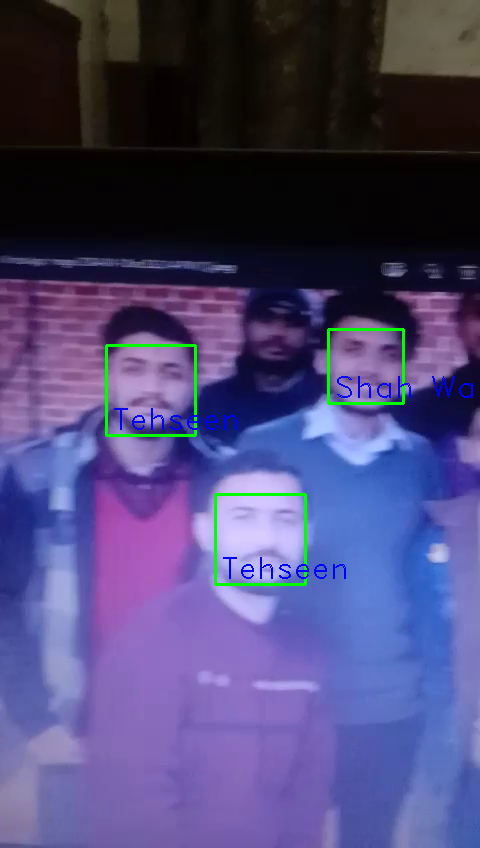

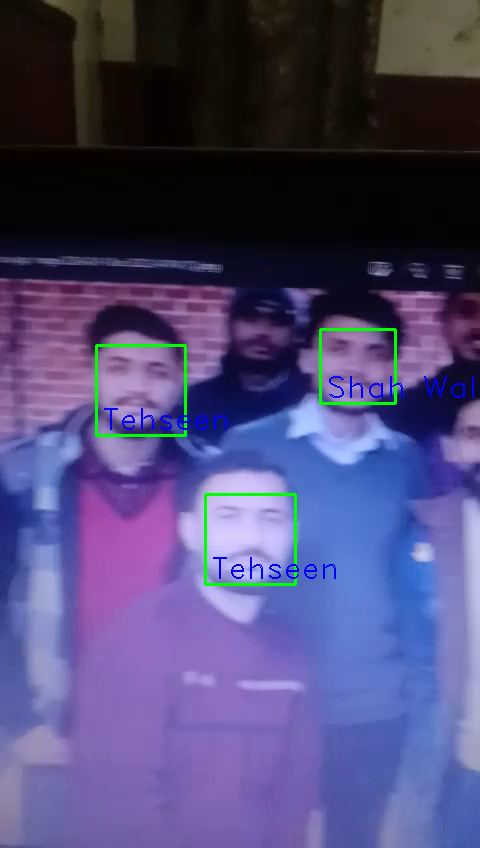

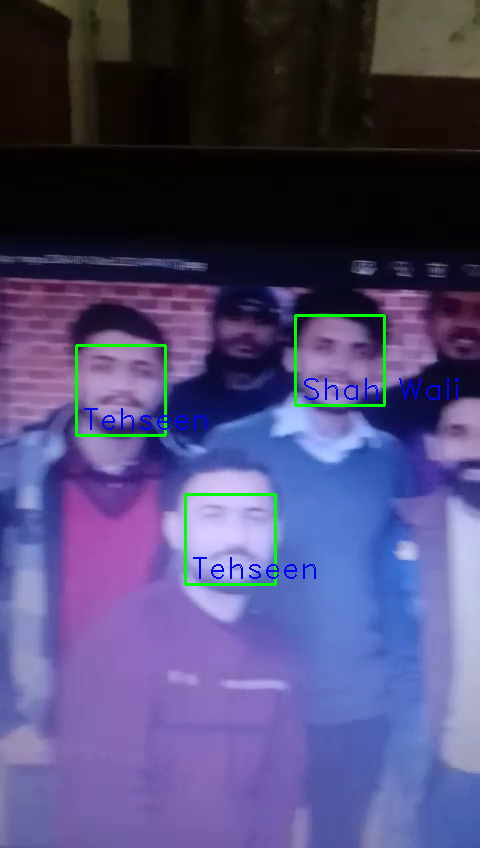

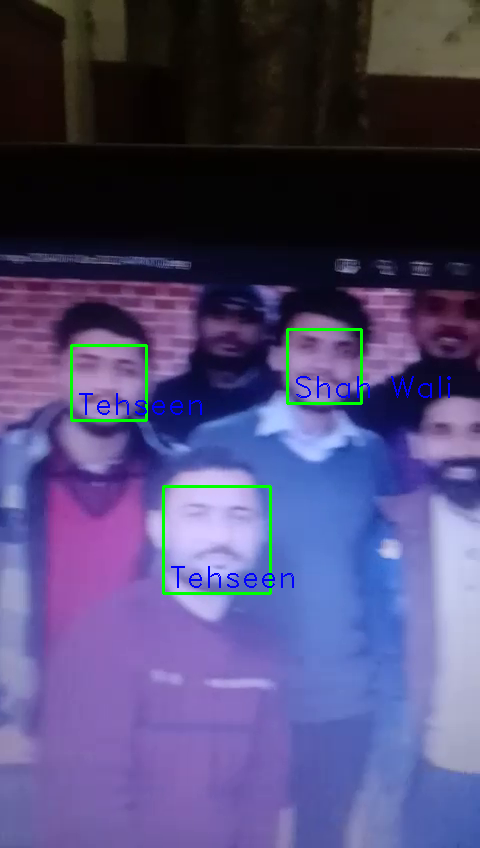

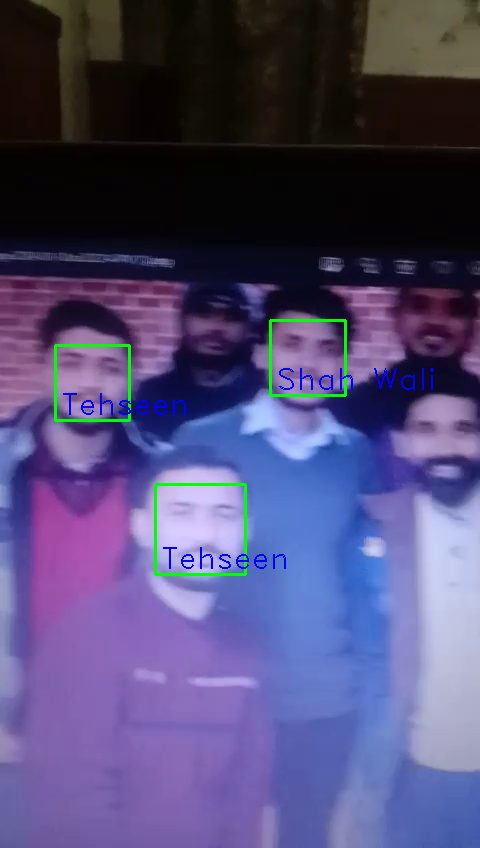

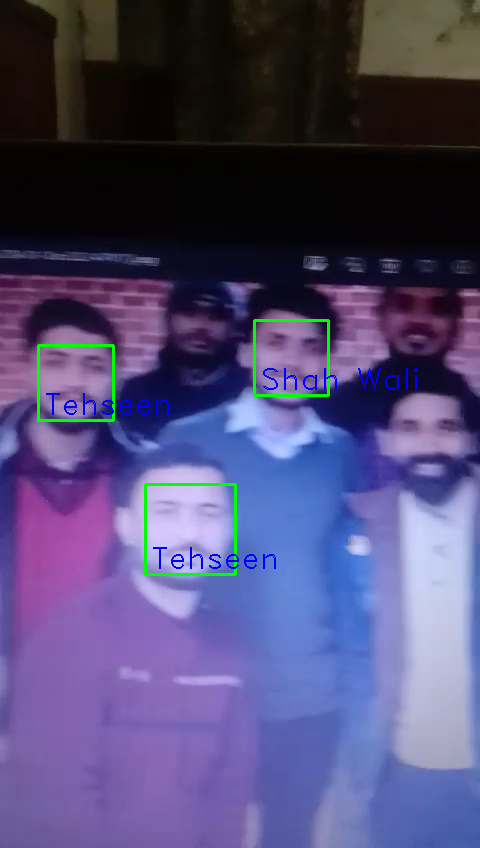

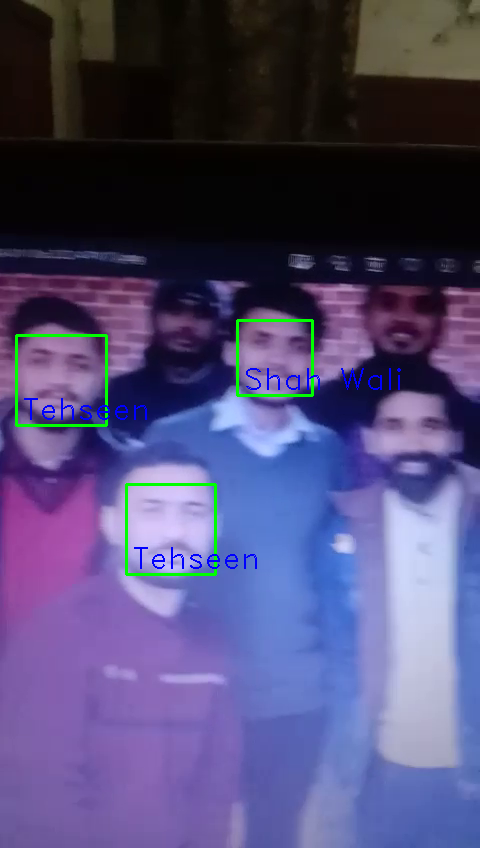

<ipython-input-8-f133b23df483>:48: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,


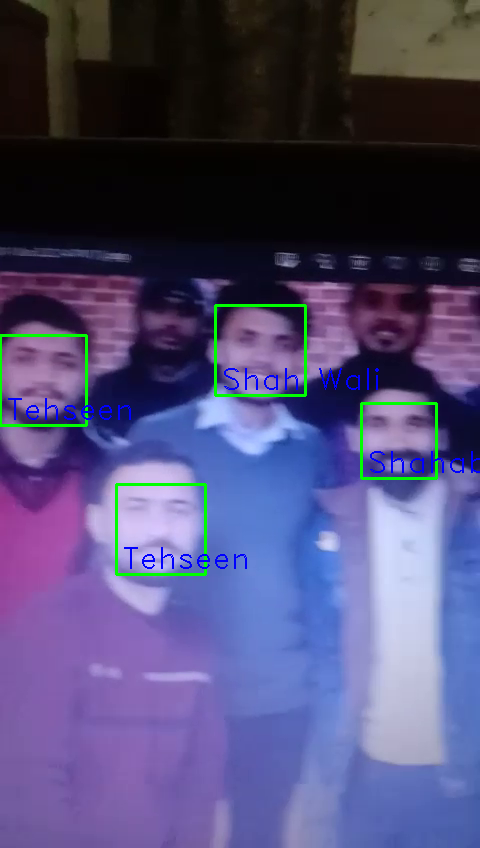

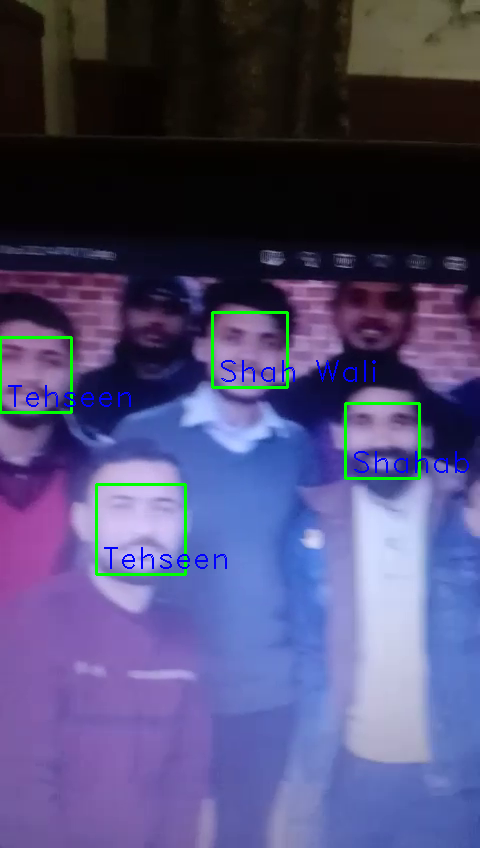

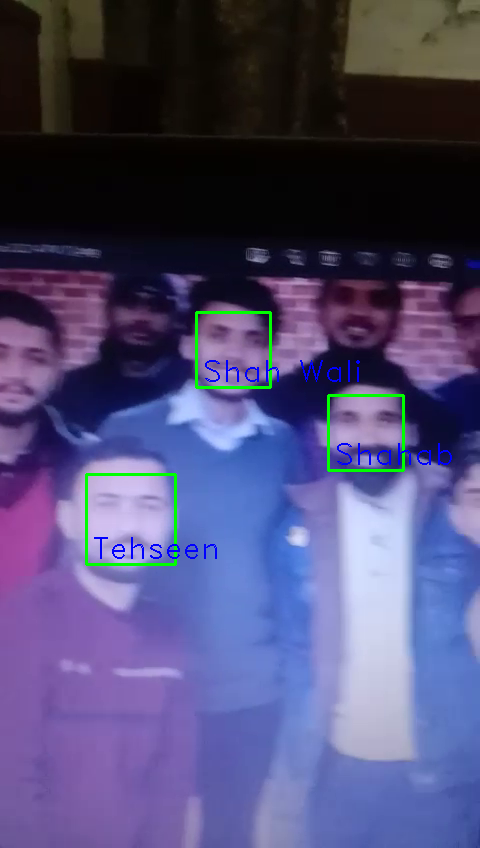

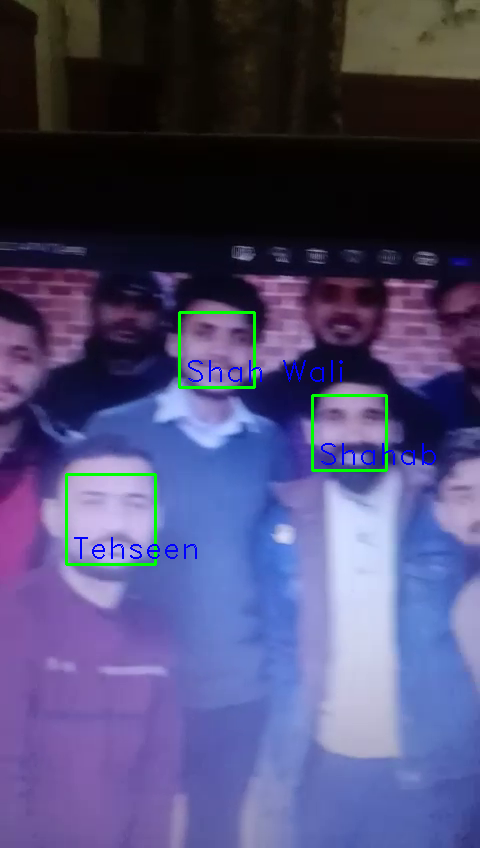

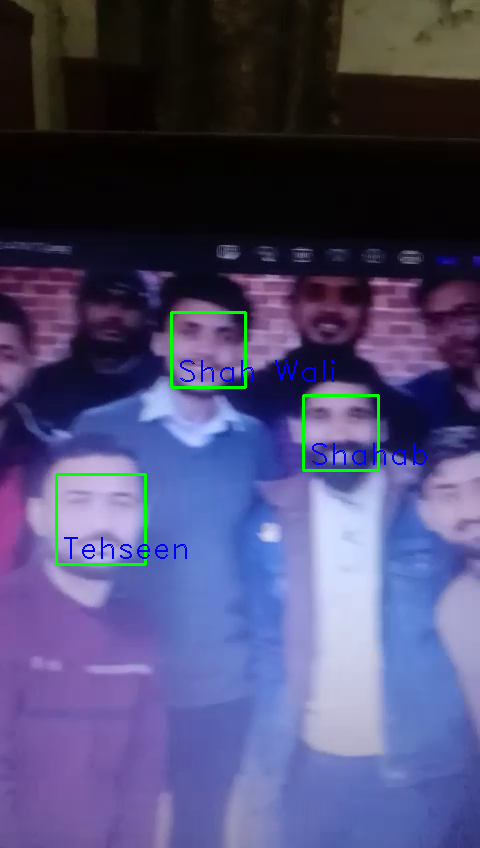

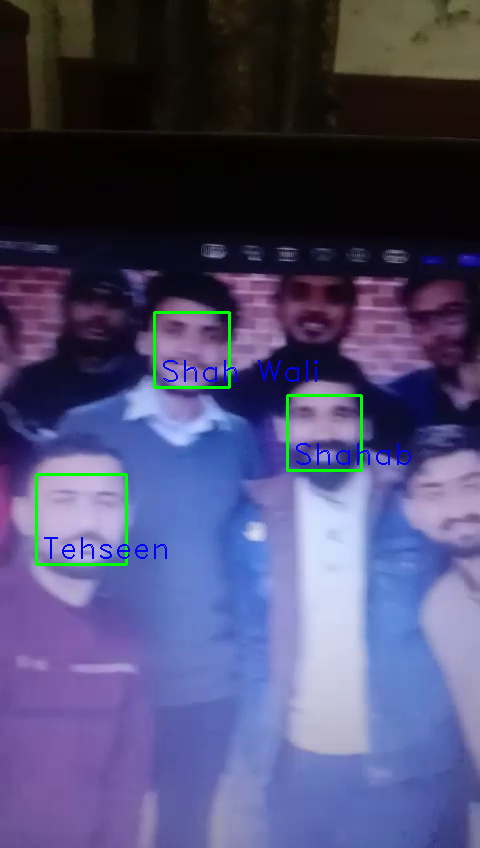

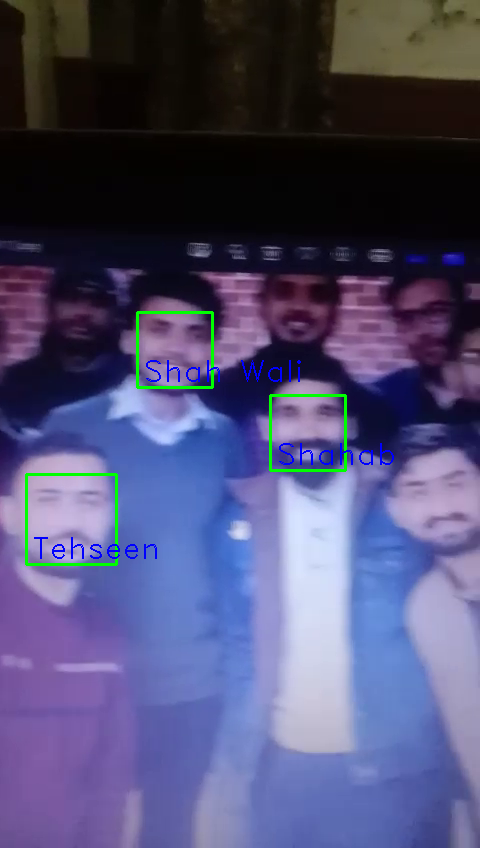

<ipython-input-8-f133b23df483>:48: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,


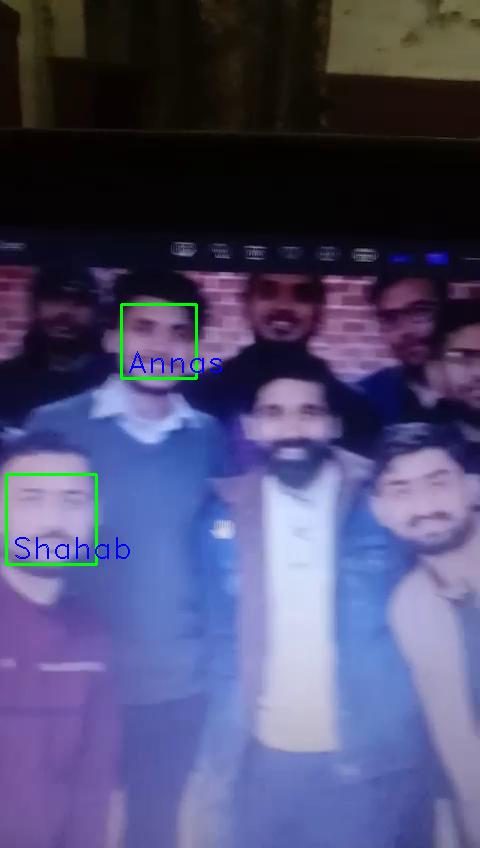

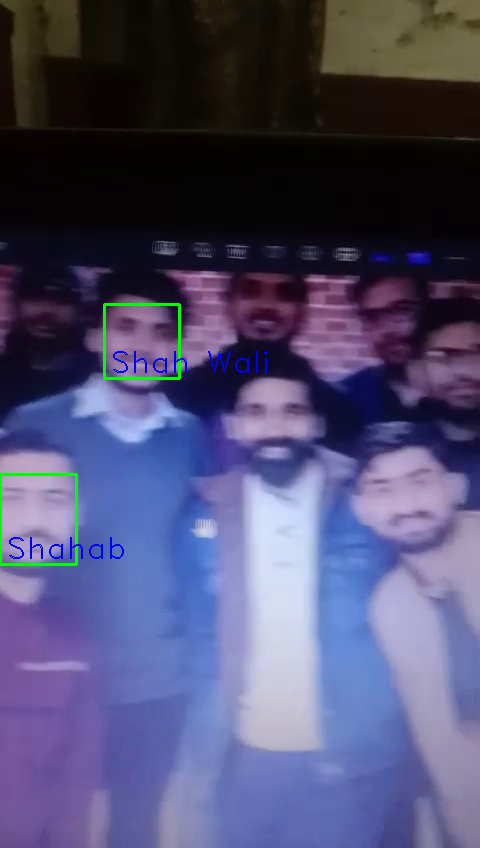

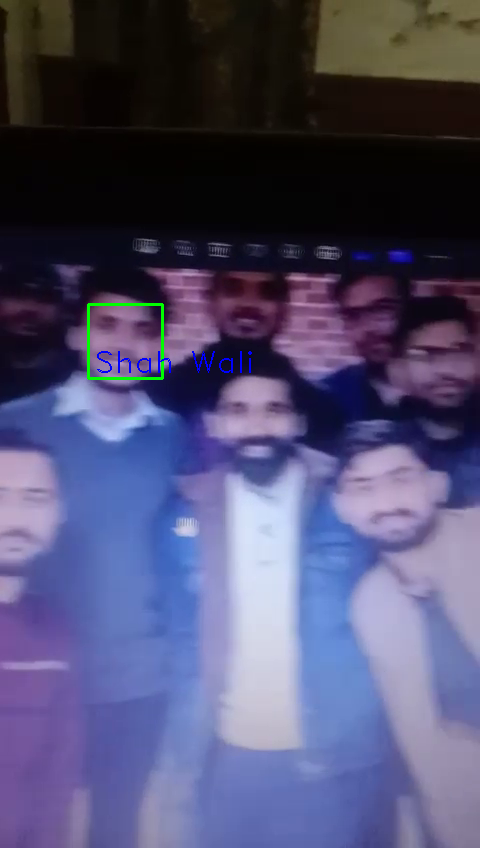

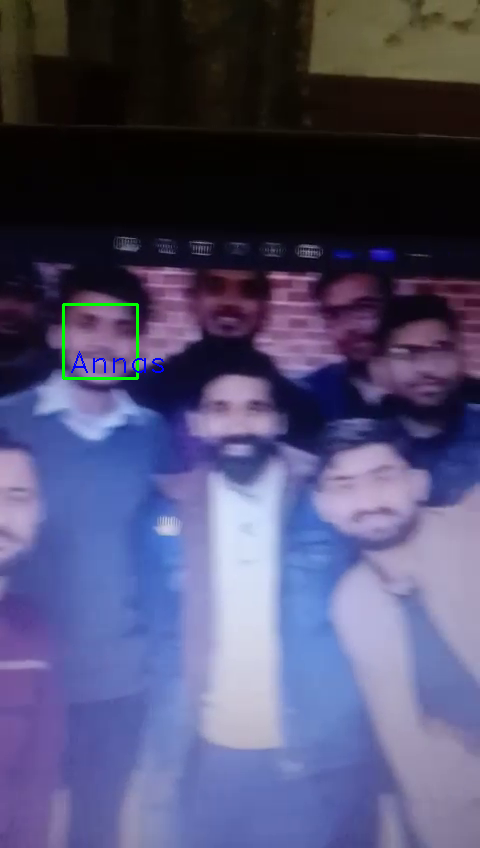

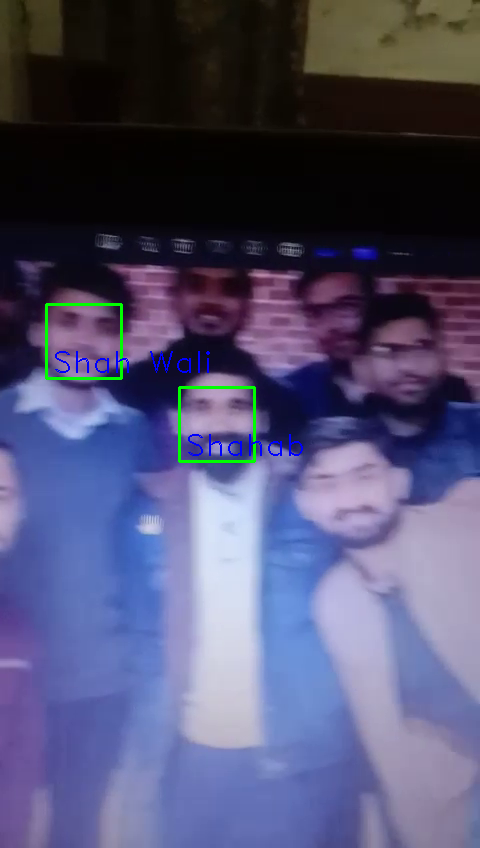

...

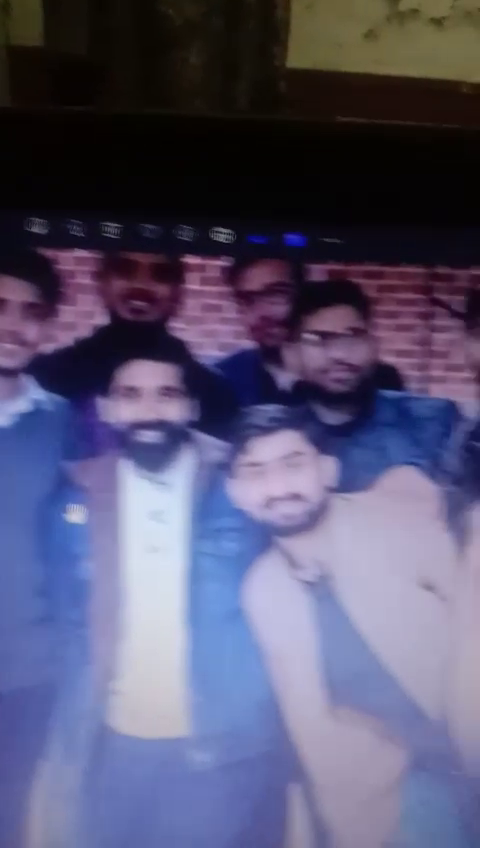

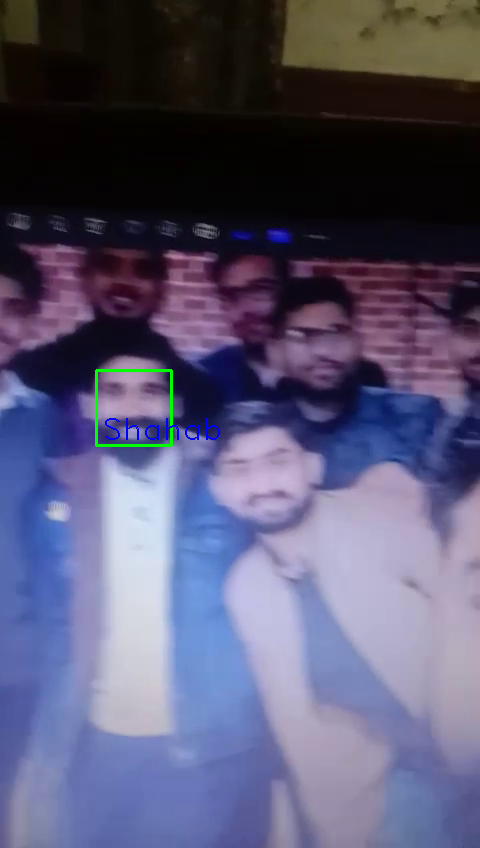

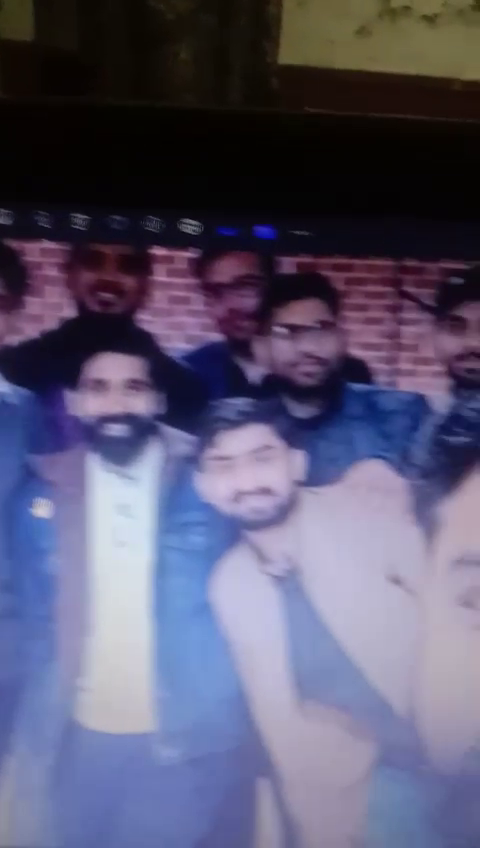

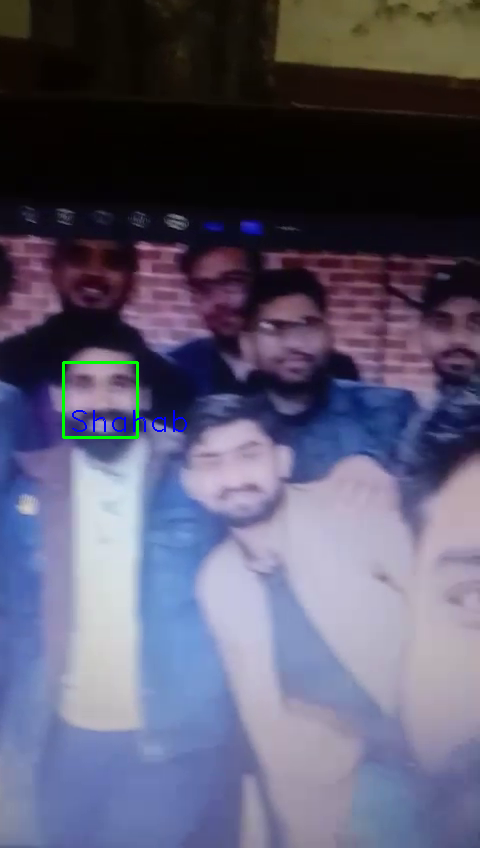

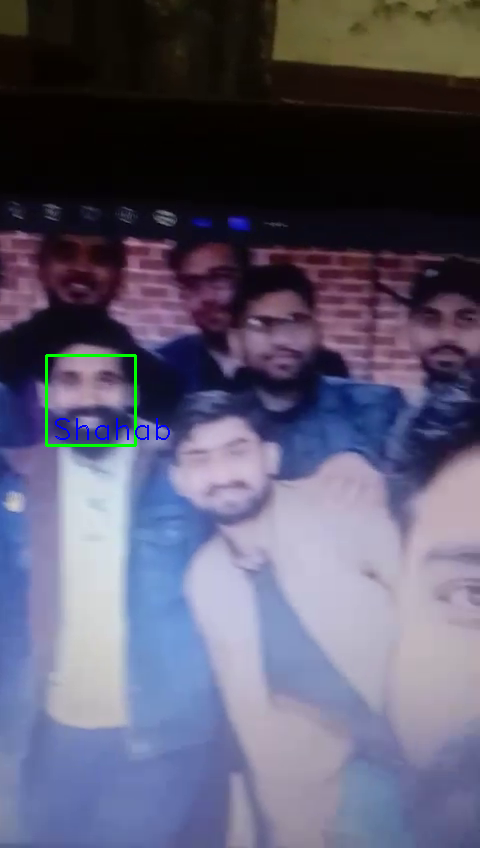

<ipython-input-8-f133b23df483>:48: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,


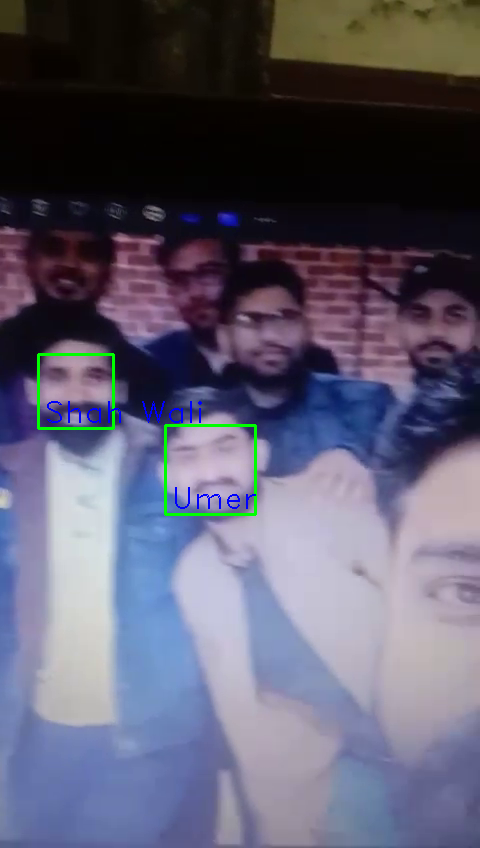

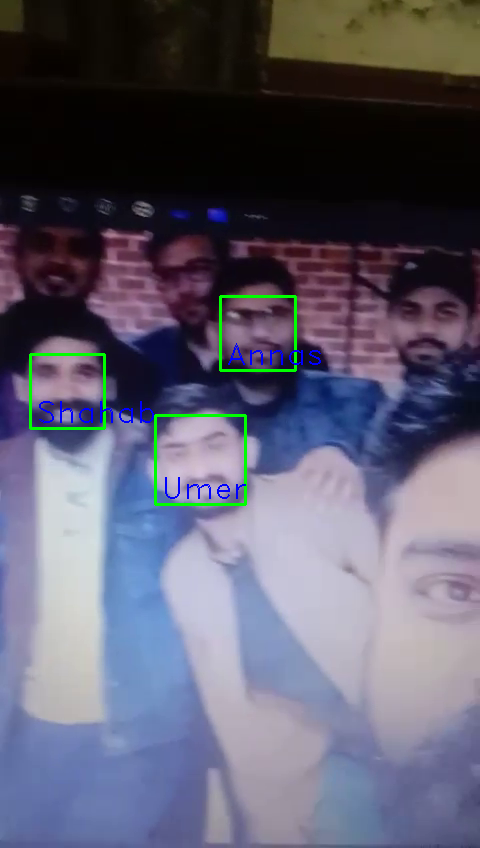

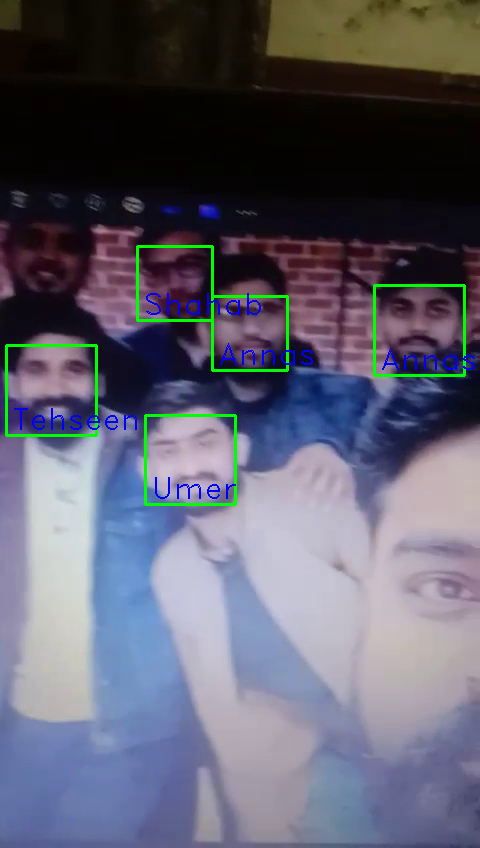

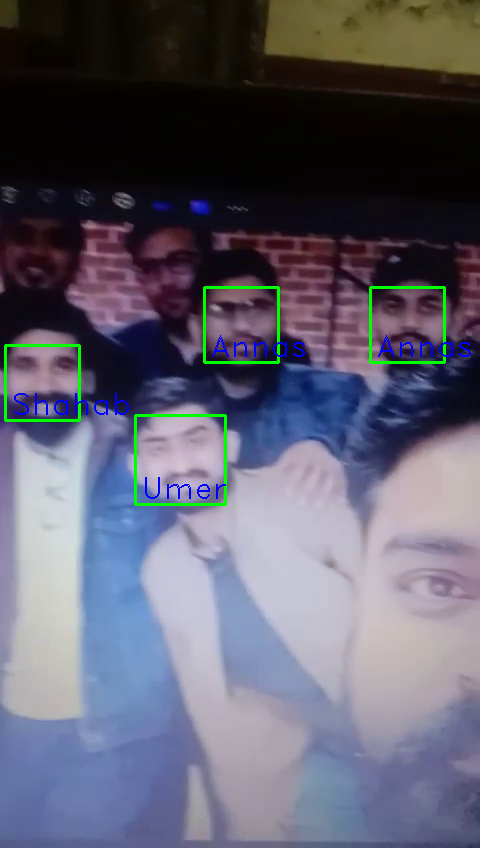

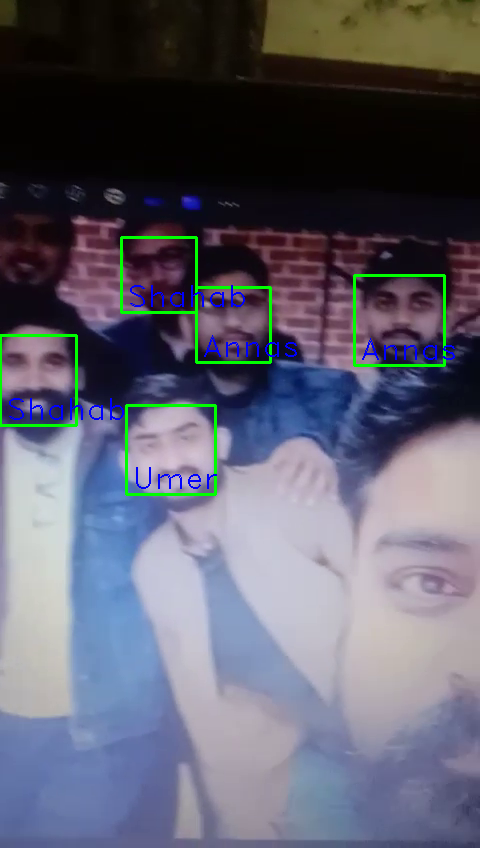

...

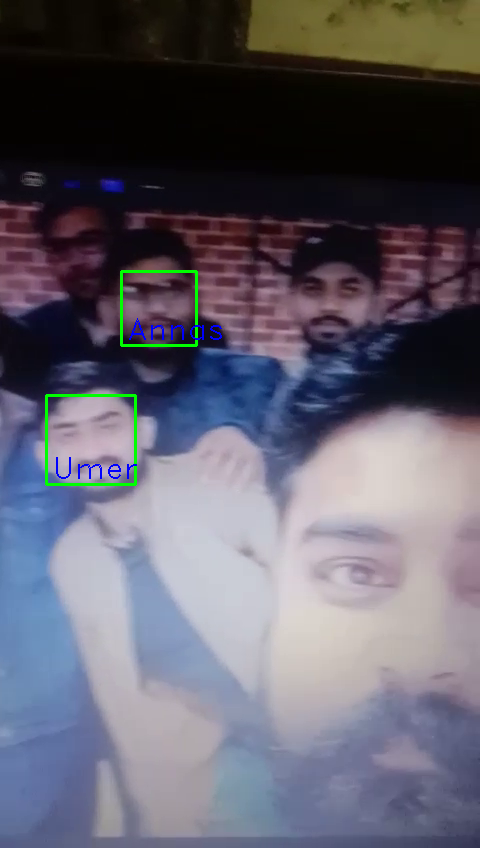

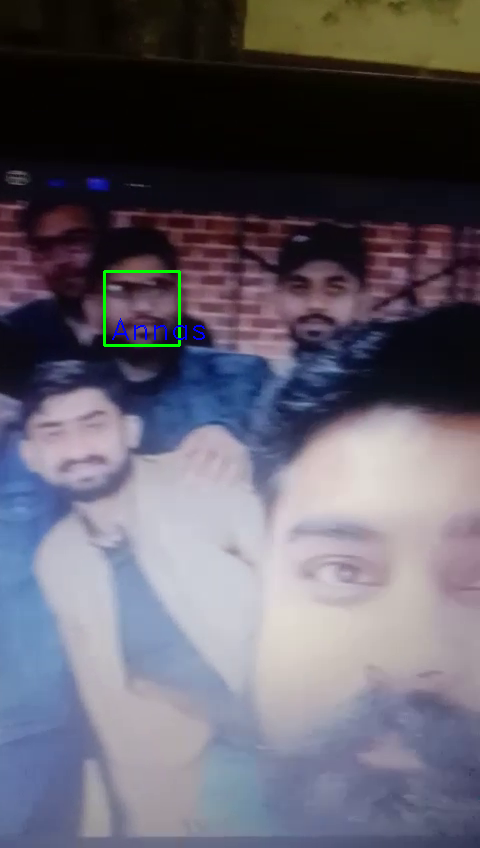

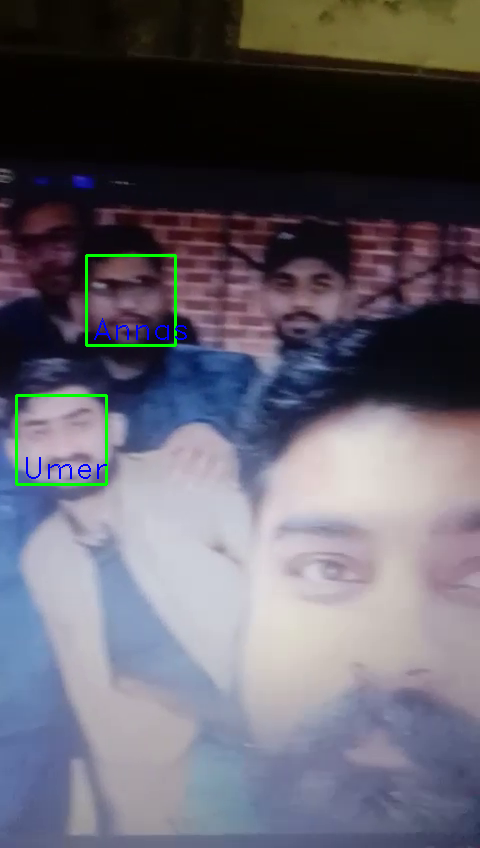

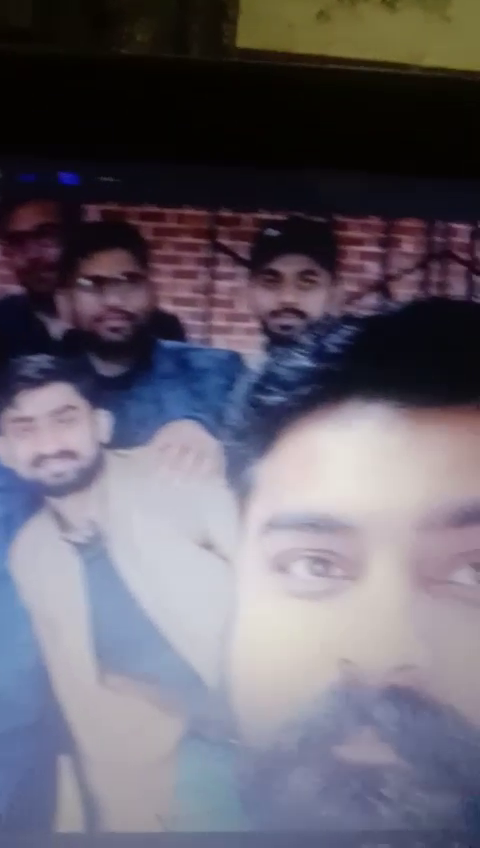

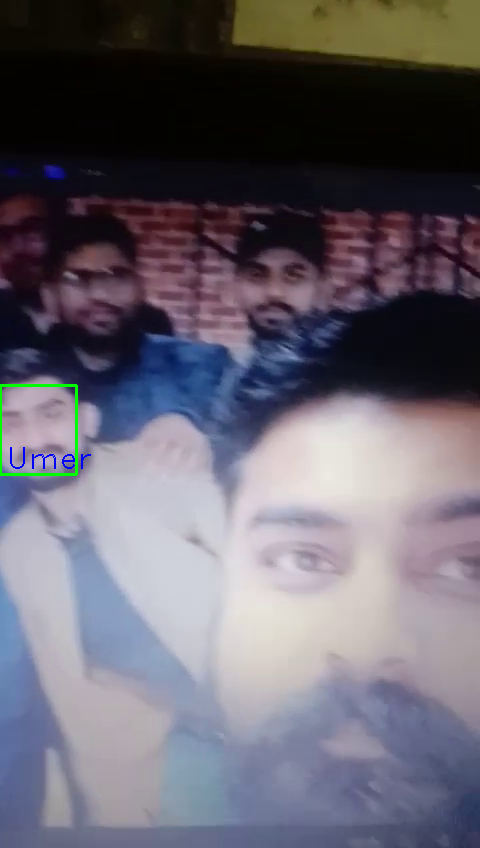

<ipython-input-8-f133b23df483>:48: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,


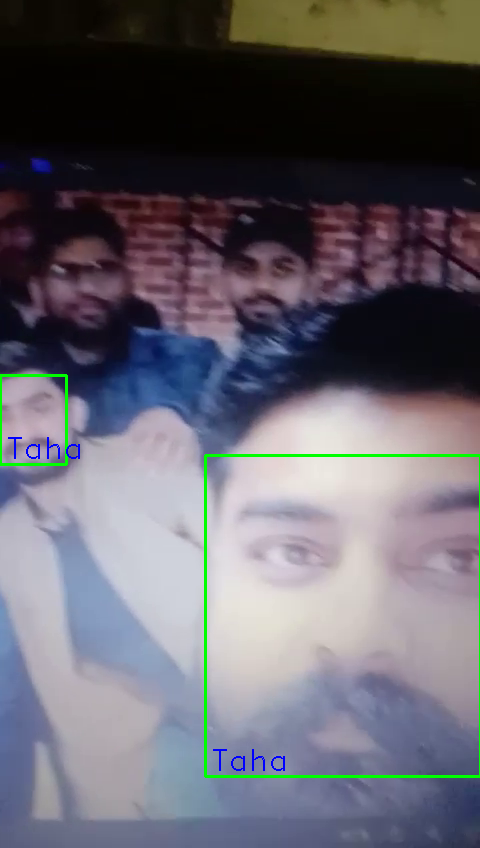

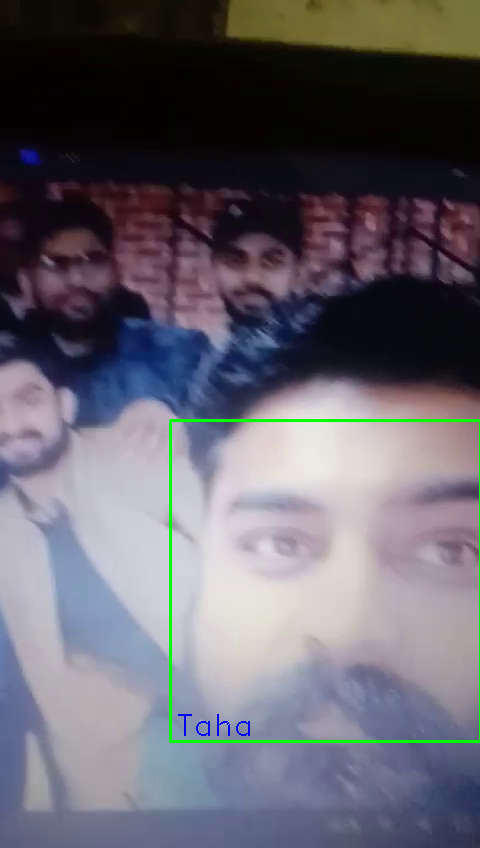

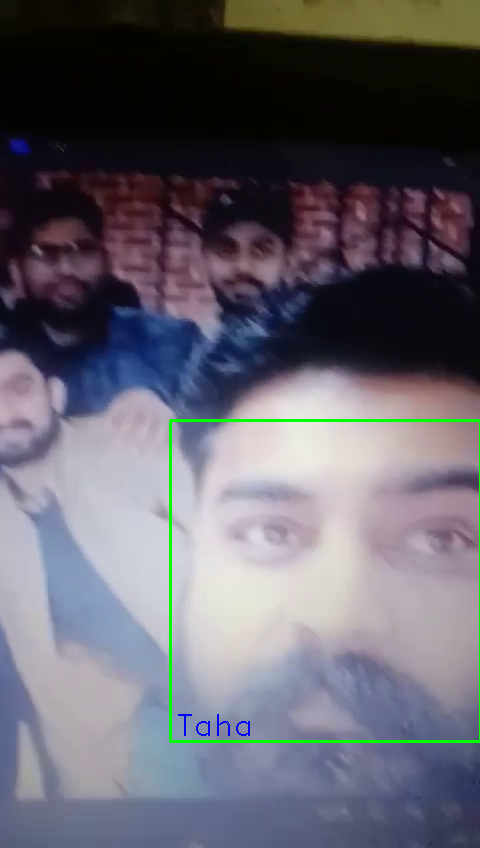

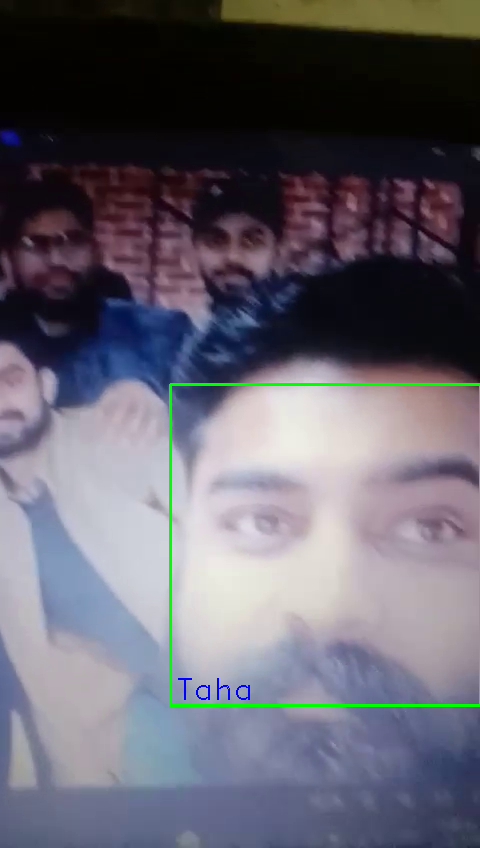

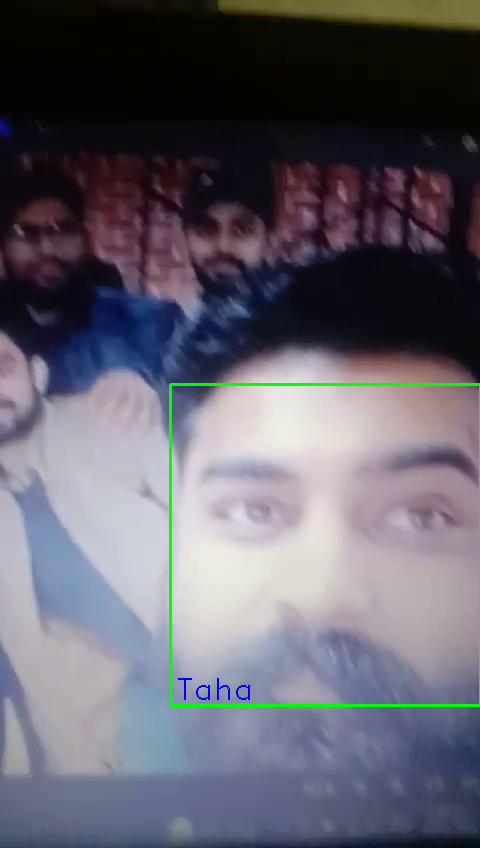

...

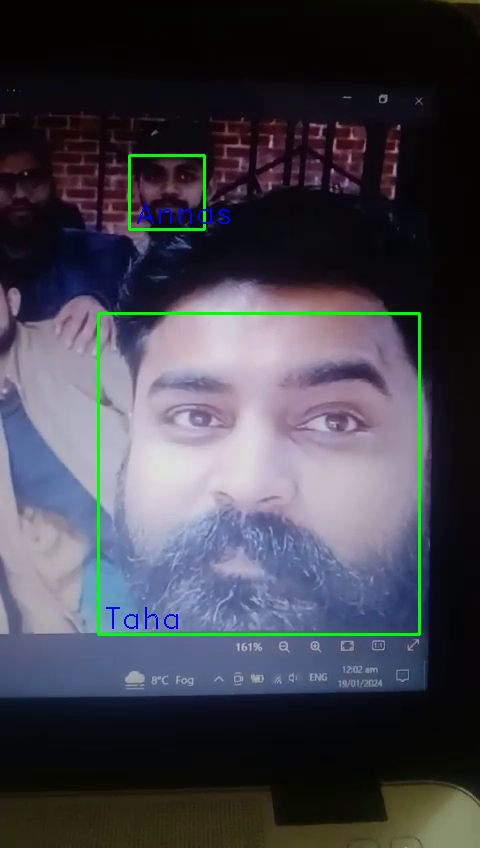

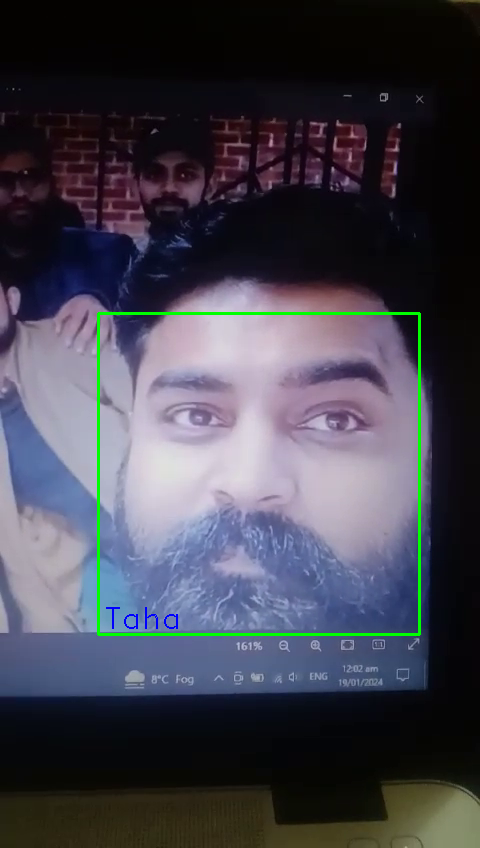

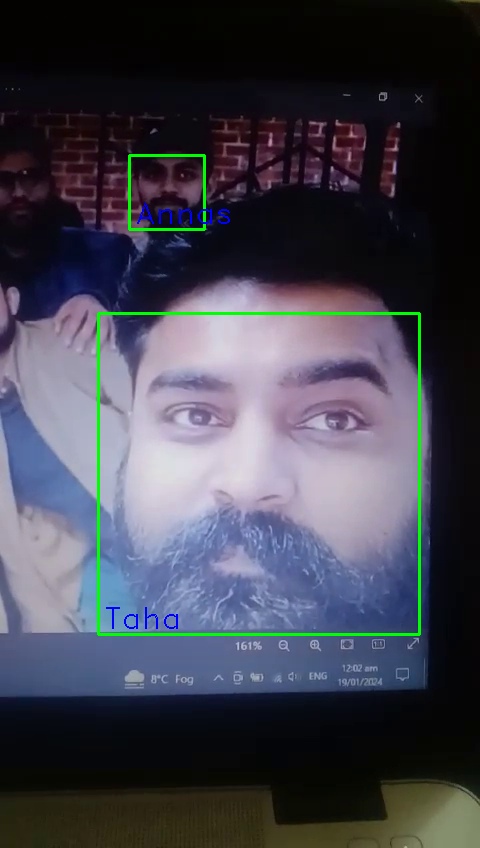

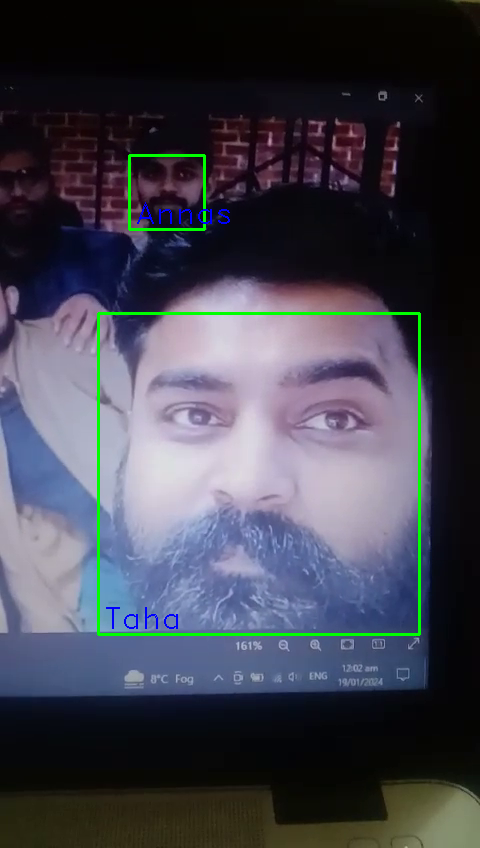

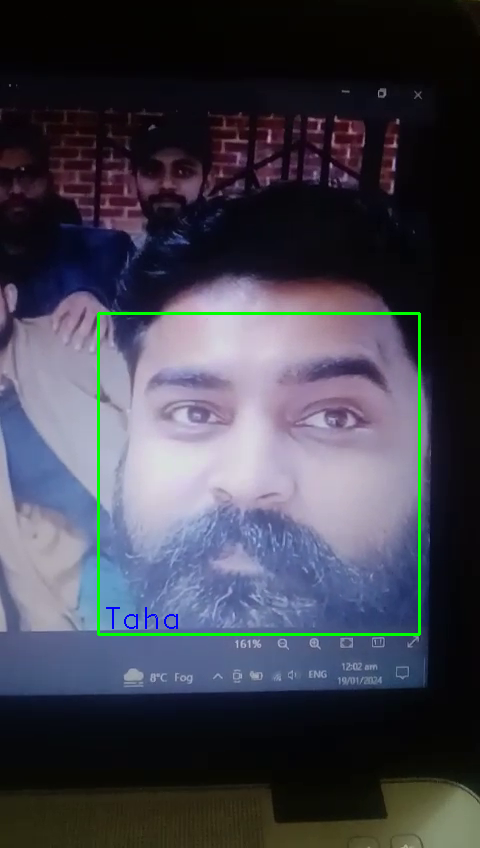

In [ ]:
import cv2
import face_recognition
import pandas as pd
from google.colab.patches import cv2_imshow
import os
import time
import datetime

# Function to recognize faces in a video and update Excel sheet
def recognize_faces_in_video(video_path, model_path, excel_path):
    # Load the trained model
    with open(model_path, 'rb') as model_file:
        knn_clf = pickle.load(model_file)

    # Check if the Excel file exists; create a new one if not
    if not os.path.exists(excel_path):
        df = pd.DataFrame(columns=['Timestamp', 'Date', 'Student Name', 'Appearance Time', 'Disappearance Time'])
        df.to_excel(excel_path, index=False)

    # Load the Excel file
    df = pd.read_excel(excel_path)

    # Open the video file
    video_capture = cv2.VideoCapture(video_path)

    while video_capture.isOpened():
        # Read a single frame from the video
        ret, frame = video_capture.read()

        if not ret:
            break

        # Find all face locations in the current frame
        face_locations = face_recognition.face_locations(frame)
        face_encodings = face_recognition.face_encodings(frame, face_locations)

        for face_location, face_encoding in zip(face_locations, face_encodings):
            # Predict the student name
            name = knn_clf.predict([face_encoding])[0]

            # Get the current timestamp
            timestamp = datetime.datetime.now().strftime("%H:%M:%S")
            date = datetime.datetime.now().strftime("%Y-%m-%d")

            # Check if the student has appeared before
            if name not in df['Student Name'].values:
                # Student is appearing for the first time
                df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,
                                'Appearance Time': timestamp, 'Disappearance Time': ''}, ignore_index=True)
            else:
                # Update the disappearance time for the student
                df.loc[df['Student Name'] == name, 'Disappearance Time'] = timestamp

            # Draw a box around the face
            top, right, bottom, left = face_location
            cv2.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 2)

            # Draw the name on the image with larger font size and a different color
            font = cv2.FONT_HERSHEY_DUPLEX
            fontScale = 1.0
            fontColor = (255, 0, 0)  # Blue color
            cv2.putText(frame, name, (left + 6, bottom - 6), font, fontScale, fontColor, 1)

        # Display the resulting frame
        cv2_imshow(frame)

        # Break the loop if 'q' key is pressed
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Save the updated Excel file
    df.to_excel(excel_path, index=False)

    # Release the video capture object
    video_capture.release()
    cv2.destroyAllWindows()

# Test the face recognition on a video
model_path = '/content/drive/MyDrive/Project/face_recognition_model.pkl'
video_path = '/content/erer.mp4'
excel_path = '/content/attendance_log.xlsx'
recognize_faces_in_video(video_path, model_path, excel_path)

In [ ]:
import os
import face_recognition
import cv2
import time
from sklearn import neighbors
import pandas as pd

# Load training data
def load_training_data(data_path):
    X = []
    y = []

    for class_folder in os.listdir(data_path):
        class_path = os.path.join(data_path, class_folder)
        for image_file in os.listdir(class_path):
            image_path = os.path.join(class_path, image_file)
            image = face_recognition.load_image_file(image_path)
            face_encodings = face_recognition.face_encodings(image)

            if len(face_encodings) > 0:
                X.append(face_encodings[0])
                y.append(class_folder)

    return X, y

# Function to recognize faces in a video and log attendance
def recognize_faces_in_video(video_path, X, y, model_path, excel_path):
    # Load the trained model
    with open(model_path, 'rb') as model_file:
        knn_clf = neighbors.KNeighborsClassifier(n_neighbors=2, algorithm='ball_tree')
        knn_clf.fit(X, y)

    # Open the video file
    video_capture = cv2.VideoCapture(video_path)

    # Create or load the attendance log Excel file
    if os.path.exists(excel_path):
        df = pd.read_excel(excel_path)
    else:
        df = pd.DataFrame(columns=['Timestamp', 'Date', 'Student Name', 'Entry Time', 'Exit Time'])

    student_status = {}  # To track entry and exit times of students

    while video_capture.isOpened():
        # Read a single frame from the video
        ret, frame = video_capture.read()

        if not ret:
            break

        # Find all face locations in the current frame
        face_locations = face_recognition.face_locations(frame)
        face_encodings = face_recognition.face_encodings(frame, face_locations)

        for face_location, face_encoding in zip(face_locations, face_encodings):
            # Predict the student name
            name = knn_clf.predict([face_encoding])[0]

            # Draw a box around the face
            top, right, bottom, left = face_location
            cv2.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 2)

            # Draw the name on the image with larger font size and a different color
            font = cv2.FONT_HERSHEY_DUPLEX
            fontScale = 1.0
            fontColor = (255, 0, 0)  # Blue color
            cv2.putText(frame, name, (left + 6, bottom - 6), font, fontScale, fontColor, 1)

            # Log the attendance
            timestamp = time.strftime("%H:%M:%S")
            date = time.strftime("%Y-%m-%d")

            if name not in student_status:
                student_status[name] = {'Entry Time': timestamp, 'Exit Time': None}
                df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,
                                'Entry Time': timestamp, 'Exit Time': None}, ignore_index=True)
            else:
                student_status[name]['Exit Time'] = timestamp
                df.loc[(df['Student Name'] == name) & (df['Exit Time'].isnull()), 'Exit Time'] = timestamp

        # Display the resulting frame
        from google.colab.patches import cv2_imshow
        cv2_imshow(frame)

        # Break the loop if 'q' key is pressed
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the video capture object
    video_capture.release()
    cv2.destroyAllWindows()

    # Save the attendance log to Excel file
    df.to_excel(excel_path, index=False)

# Load training data and model
data_path = '/content/drive/MyDrive/Project/Classmates'  # Replace with your training data path
model_path = '/content/drive/MyDrive/Project/face_recognition_model.pkl'  # Replace with your model path
excel_path = '/content/log.xlsx'  # Replace with your attendance log path

X, y = load_training_data(data_path)

In [ ]:
import pickle

# Save X and y to a file
data_path = '/content/training_data.pkl'
with open(data_path, 'wb') as data_file:
    pickle.dump((X, y), data_file)

# # Later, when you need to use the training data
# with open(data_path, 'rb') as data_file:
#     loaded_X, loaded_y = pickle.load(data_file)


In [ ]:
# Test the face recognition on a video
video_path = '/content/erer.mp4'
recognize_faces_in_video(video_path, X, y, model_path, excel_path)

In [ ]:
import os
import face_recognition
import cv2
import time
from sklearn import neighbors
import pandas as pd

# Function to recognize faces in a video and log attendance
def recognize_faces_in_video(video_path, model_path, excel_path):
    # Load the trained model
    with open(model_path, 'rb') as model_file:
        knn_clf = neighbors.KNeighborsClassifier(n_neighbors=2, algorithm='ball_tree')

    # Open the video file
    video_capture = cv2.VideoCapture(video_path)

    # Create or load the attendance log Excel file
    if os.path.exists(excel_path):
        df = pd.read_excel(excel_path)
    else:
        df = pd.DataFrame(columns=['Timestamp', 'Date', 'Student Name', 'Entry Time', 'Exit Time'])

    student_status = {}  # To track entry and exit times of students

    while video_capture.isOpened():
        # Read a single frame from the video
        ret, frame = video_capture.read()

        if not ret:
            break

        # Find all face locations in the current frame
        face_locations = face_recognition.face_locations(frame)
        face_encodings = face_recognition.face_encodings(frame, face_locations)

        for face_location, face_encoding in zip(face_locations, face_encodings):
            # Predict the student name
            name = knn_clf.predict([face_encoding])[0]

            # Draw a box around the face
            top, right, bottom, left = face_location
            cv2.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 2)

            # Draw the name on the image with larger font size and a different color
            font = cv2.FONT_HERSHEY_DUPLEX
            fontScale = 1.0
            fontColor = (255, 0, 0)  # Blue color
            cv2.putText(frame, name, (left + 6, bottom - 6), font, fontScale, fontColor, 1)

            # Log the attendance
            timestamp = time.strftime("%H:%M:%S")
            date = time.strftime("%Y-%m-%d")

            if name not in student_status:
                student_status[name] = {'Entry Time': timestamp, 'Exit Time': None}
                df = df.append({'Timestamp': timestamp, 'Date': date, 'Student Name': name,
                                'Entry Time': timestamp, 'Exit Time': None}, ignore_index=True)
            else:
                student_status[name]['Exit Time'] = timestamp
                df.loc[(df['Student Name'] == name) & (df['Exit Time'].isnull()), 'Exit Time'] = timestamp

        # Display the resulting frame
        from google.colab.patches import cv2_imshow
        cv2_imshow(frame)

        # Break the loop if 'q' key is pressed
        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the video capture object
    video_capture.release()
    cv2.destroyAllWindows()

    # Save the attendance log to Excel file
    df.to_excel(excel_path, index=False)

# Test the face recognition on a video
model_path = '/content/drive/MyDrive/Project/face_recognition_model.pkl'
video_path = '/content/erer.mp4'
excel_path = '/content/attendance_log.xlsx'
recognize_faces_in_video(video_path, model_path, excel_path)


# **WEB Cam**

In [ ]:
!pip install face_recognition==1.3.0
!pip install dlib==19.22.0

In [ ]:
import cv2
import face_recognition
import pickle

# Load the trained model
model_path = '/content/face_recognition_model.pkl'
with open(model_path, 'rb') as model_file:
    knn_clf = pickle.load(model_file)

# Open the webcam
video_capture = cv2.VideoCapture(0)

while True:
    # Capture video frame-by-frame
    ret, frame = video_capture.read()

    # Find all face locations in the current frame
    face_locations = face_recognition.face_locations(frame)
    face_encodings = face_recognition.face_encodings(frame, face_locations)

    for face_location, face_encoding in zip(face_locations, face_encodings):
        # Predict the student name
        name = knn_clf.predict([face_encoding])[0]

        # Draw a box around the face
        top, right, bottom, left = face_location
        cv2.rectangle(frame, (left, top), (right, bottom), (0, 255, 0), 2)

        # Draw the name on the image with larger font size and a different color
        font = cv2.FONT_HERSHEY_DUPLEX
        fontScale = 1.0
        fontColor = (255, 0, 0)  # Blue color
        cv2.putText(frame, name, (left + 6, bottom - 6), font, fontScale, fontColor, 1)

    # Display the resulting frame
    cv2.imshow('Webcam Face Recognition', frame)

    # Break the loop if 'q' key is pressed
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Release the webcam
video_capture.release()
cv2.destroyAllWindows()
